# DATA VISUALIZATION PROJECT

###  US Prevailing Wage Program

#### TEAM MEMBERS : 

1. Keshav Balivada
2. Eswar Chand Thokala
3. Sharath Cherukuri
4. Jyotsna Jakkam
5. Jasti Sai Vignesh


In [1]:
#Importing necessary packages
import numpy as np 
import pandas as pd 
#Reading the data
df = pd.read_excel(
    'PW_Disclosure_Data_FY2020.xlsx',
    sheet_name='PW_FY2020Q4'
    )

print('Data downloaded and read into a dataframe!')

Data downloaded and read into a dataframe!


In [2]:
#Shape of the data frame
df.shape

(166525, 78)

In [3]:
df.head()

,CASE_NUMBER,CASE_STATUS,RECEIVED_DATE,DETERMINATION_DATE,REDETERMINATION_DATE,CENTER_DIRECTOR_REVIEW_DATE,WITHDRAWAL_DATE,VISA_CLASS,REQUESTOR_POC_LAST_NAME,REQUESTOR_POC_FIRST_NAME,...,OTHER_WORKSITE_LOCATION,PWD_SOC_CODE,PWD_SOC_TITLE,PWD_WAGE_RATE,PWD_OES_WAGE_LEVEL,PWD_UNIT_OF_PAY,PWD_WAGE_SOURCE,PWD_SURVEY_NAME,WAGE_DET_NOTES,PWD_WAGE_EXPIRATION_DATE
0,P-100-18302-187834,Redetermination Affirmed,2019-05-24,2019-09-09,2019-10-31,NaT,NaT,PERM,WEST,JENNIFER,...,Y,11-3021.00,Computer and Information Systems Managers,199534.0,Level IV,Year,OES,NaN,NaN,2020-06-30
1,P-100-18306-211405,Withdrawn,2018-11-02,NaT,NaT,NaT,2020-02-02,PERM,AL AZZAWI,MOHANAD,...,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT
2,P-100-18353-210924,Redetermination Modified,2019-04-23,2019-10-25,2019-10-25,NaT,NaT,PERM,LANG,NILES,...,Y,47-3015.00,"Helpers--Pipelayers, Plumbers, Pipefitters, an...",40955.0,Level IV,Year,OES,NaN,NaN,2020-06-30
3,P-100-19013-734977,Withdrawn,2019-01-13,NaT,NaT,NaT,2019-12-19,PERM,JIN,ZHEN,...,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT
4,P-100-19036-214674,Center Director Review Modified Determination,2019-02-15,2019-10-21,2019-08-13,2019-10-21,NaT,PERM,KETCHER,ADAM,...,N,13-1161.00,Market Research Analysts and Marketing Special...,99362.0,Level IV,Year,OES,NaN,NaN,2020-06-30


In [4]:
#Statistical analysis of the data
df.describe()

,NAICS_CODE,SUPERVISE_HOW_MANY,NUMBER_OF_MONTHS_TRAINING,EMP_EXPERIENCE_MONTHS,PWD_WAGE_RATE
count,166496.00000,19179.000000,4240.000000,125894.000000,161032.000000
mean,356521.92350,7.900099,19.177358,34.614445,83949.170504
std,244626.67063,80.460440,22.818714,27.021048,47109.534133
min,1111.00000,0.000000,0.000000,0.000000,7.270000
25%,54161.00000,2.000000,0.000000,12.000000,53851.000000
50%,511210.00000,4.000000,6.000000,24.000000,86965.000000
75%,541511.00000,6.000000,36.000000,60.000000,113672.000000
max,928120.00000,9999.000000,120.000000,3672.000000,319254.960000


In [5]:
! pip install plotly

### Plot 1 :  Pie Chart

In [6]:
# Contribution :  Sharath Cherukuri
import plotly.express as px
data = px.data.gapminder()

#Pie chart of the data
df2 = pd.DataFrame(df.groupby(["VISA_CLASS"])["CASE_NUMBER"].count())
df2.reset_index(inplace=True)
df2 =df2.rename(columns={'CASE_NUMBER': 'CASE_COUNT'}, inplace=False)
fig = px.pie(df2, values='CASE_COUNT', names='VISA_CLASS', title ="TOTAL CASES PER VISA CLASS")
fig.show()

## Analysis:

Max - 87.5% of cases are in PERM VISA class <br>
Min - 0.0084% of cases are in H1-B1 Chile class

### Plot 2 :  Bar Chart

In [7]:
# Contribution :  Keshav Balivada
import plotly.express as px
data = px.data.gapminder()

#Bar chart is plotted

df3 = pd.DataFrame(df.groupby(["REQUESTOR_POC_COUNTRY","REQUESTOR_POC_STATE"])["CASE_NUMBER"].count())

df3.reset_index(inplace=True)
df3 =df3.rename(columns={'CASE_NUMBER': 'CASE_COUNT'}, inplace=False)
df3=df3.sort_values(by="CASE_COUNT",ascending=False)

data_usa = df3[df3["REQUESTOR_POC_COUNTRY"]=="UNITED STATES OF AMERICA"]
fig = px.bar(data_usa, x='REQUESTOR_POC_STATE', y='CASE_COUNT',
             hover_data=['REQUESTOR_POC_STATE', 'CASE_COUNT'], color='REQUESTOR_POC_STATE',
             labels={'CASE_COUNT':'Count of Cases',
                     'REQUESTOR_POC_STATE':'USA States'
                    }, height=400, title="TOTAL CASES IN EACH USA STATE")
fig.show()

### Plot 3 : Horizontal Bar Chart

In [8]:
# Contribution :  Sharath Cherukuri
#Horizontal Bar chart

df3=df["CASE_STATUS"].value_counts().reset_index(name="Count")
df3.columns=['CASE_STATUS',"Count"]
px.bar(df3, x='Count', y='CASE_STATUS',
        color='Count',
        title = 'Number of Cases per Case Status')

### Plot 4 : Word Cloud **Occupation Required**

In [9]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


<ipython-input-10-dff93f4eefc9>:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



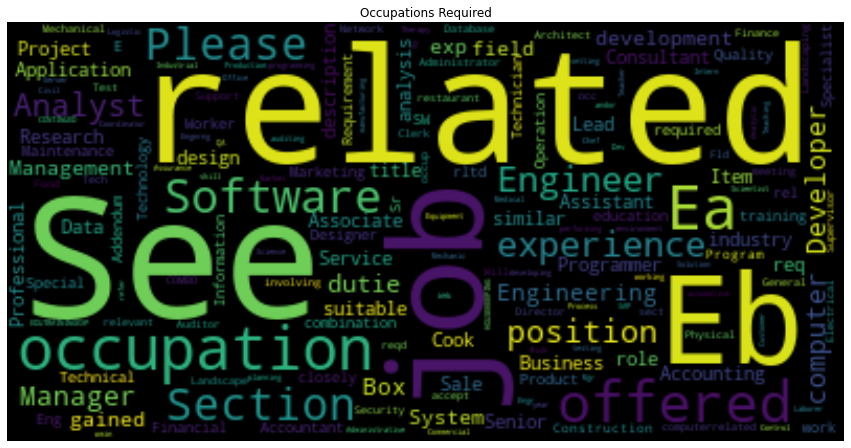

In [10]:
# Contribution :  Jasti Sai Vignesh

import datetime
from wordcloud import WordCloud, STOPWORDS
import urllib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Data preprocessing 

ht = df[["OCCUPATION_REQUIRED"]]
ht.dropna(inplace=True)
ht=ht[ht["OCCUPATION_REQUIRED"]!=12]
ht=ht[ht["OCCUPATION_REQUIRED"]!=35.2014]
ht=ht[ht["OCCUPATION_REQUIRED"]!='3021-11-01']
ht=ht[ht["OCCUPATION_REQUIRED"]!='3021-11-01 00:00:00']

#Removing unwanted characters and symbols from the article
stopchar = '''@#$%^&*_~â!()-[]{};:'"\,<>./?€œ�™123456789'''
filtered_ls = []
for i in range(ht.shape[0]): 
    filtertxt = ""
    text = ht.iloc[i][0]
    if(isinstance(text, datetime.datetime)):
        continue
    if(isinstance(text, int)):
        continue
    for t in text:
        if t not in stopchar:
            filtertxt = filtertxt + t 
    filtered_ls.append(filtertxt)
filtered_string = ' '.join(filtered_ls)

#Getting stopwords
stopwords = set(STOPWORDS)
#Generating WordCkoud
ht_wc = WordCloud(background_color='Black',stopwords=stopwords,collocations=False)
ht_wc.generate(filtered_string)
fig = plt.figure(figsize=(15,12))
plt.imshow(ht_wc, interpolation='bilinear')
plt.title("Occupations Required")
plt.axis('off')
plt.show()
ht_wc.to_file("wordcloud.jpeg")

### Word Cloud for **Special Requirements**

<ipython-input-11-1d9a87f834c8>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



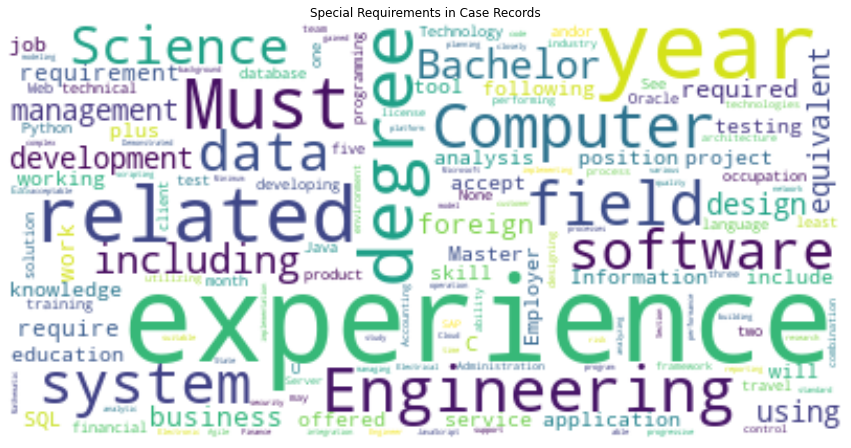

In [11]:
# Contribution :  Jasti Sai Vignesh

from wordcloud import WordCloud, STOPWORDS
import urllib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

ht = df[["SPECIAL_REQUIREMENTS"]]
ht.dropna(inplace=True)
#Removing unwanted characters and symbols from the article
stopchar = '''@#$%^&*_~â!()-[]{};:'"\,<>./?€œ�™'''
filtered_ls = []
for i in range(ht.shape[0]): 
    filtertxt = ""
    text = ht.iloc[i][0]
    for t in text:
        if t not in stopchar:
            filtertxt = filtertxt + t 
    filtered_ls.append(filtertxt)

filtered_string = ' '.join(filtered_ls)

#Getting stopwords
stopwords = set(STOPWORDS)
#Generating WordCloud
ht_wc = WordCloud(background_color='White',stopwords=stopwords,collocations=False)
ht_wc.generate(filtered_string)
fig = plt.figure(figsize=(15,12))
plt.imshow(ht_wc, interpolation='bilinear')
plt.title("Special Requirements in Case Records")
plt.axis('off')
plt.show()

### Map

In [12]:
# Contribution :  Jyotsna Jakkam

#Map chloropleth plot
df13=df.groupby(["PRIMARY_WORKSITE_STATE"])["PWD_WAGE_RATE"].agg('mean').reset_index()
fig = px.choropleth(df13,locations="PRIMARY_WORKSITE_STATE",
                    locationmode="USA-states", 
                    color='PWD_WAGE_RATE', 
                    scope="usa",
                    title="PWD_Wage_Rate per US State")
fig.show()

### Map 2

In [13]:
# Contribution :  Jyotsna Jakkam

#Map chloropleth plot

df13=df.groupby(["EMPLOYER_STATE"])["CASE_NUMBER"].agg('count').reset_index()
df13.columns=['EMPLOYER_STATE','Number of Cases Filed']
fig = px.choropleth(df13,locations="EMPLOYER_STATE",
                    locationmode="USA-states", 
                    color='Number of Cases Filed', scope="usa",
                    title="Number of Cases filed per Employer",
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

### Histogram

In [14]:
# Contribution :  Eswar Chand Thokala

#Calculating the turn around time feature

df14=df
df14["TAT"]=(df["DETERMINATION_DATE"]-df["RECEIVED_DATE"])/np.timedelta64(1,'D')

In [15]:
#Histogram
px.histogram(df14,x="TAT",title="Case Turn around time frequency in days")

In [16]:
# Contribution :  Eswar Chand Thokala

px.histogram(df14,x="TAT",color="VISA_CLASS",
             title="Case Turn around time frequency in days per VISA Category")

### Line Plot

In [17]:
# Contribution :  Eswar Chand Thokala

#Creating a line plot

df14=df[df["CASE_STATUS"]=="Determination Issued"]
df15=df14.groupby(["RECEIVED_DATE","VISA_CLASS"])["CASE_NUMBER"].agg('count').reset_index()
fig = px.line(df15, x="RECEIVED_DATE", y="CASE_NUMBER", color='VISA_CLASS',
              title="Number of Determination Issued cases across VISA CLASSES")
fig.show()

### Line plot 2

In [18]:
# Contribution :  Sharath Kumar Cherukuri
# Line plot is created 

df14=df[df["CASE_STATUS"]=="Withdrawn"]
df15=df14.groupby(["RECEIVED_DATE","VISA_CLASS"])["CASE_NUMBER"].agg('count').reset_index()
fig = px.line(df15, x="RECEIVED_DATE", y="CASE_NUMBER",
              color='VISA_CLASS',title="Number of WITHDRAWN cases across VISA CLASSES")
fig.show()

### Line graph with Range slider

In [19]:
# Contribution :  Keshav Balivada

# Interactive line graph is plotted with a time range slider

df5 = pd.DataFrame(df.groupby([df['RECEIVED_DATE'].dt.year.rename('year'), df['RECEIVED_DATE'].dt.month.rename('month')])["CASE_NUMBER"].count())
df5.reset_index(inplace=True)
df5['Date'] = pd.to_datetime(df5.year.astype(str) + '-' + df5.month.astype(str))

df5.head(5)

,year,month,CASE_NUMBER,Date
0,2018,11,1,2018-11-01
1,2019,1,1,2019-01-01
2,2019,2,1,2019-02-01
3,2019,3,4,2019-03-01
4,2019,4,12,2019-04-01


In [20]:
import plotly.graph_objects as go
fig = go.Figure()

fig.add_trace(
    go.Scatter(x=list(df5.Date), y=list(df5.CASE_NUMBER)))
    #go.Scatter(x=list(df.RECEIVED_DATE), y=list(df.CASE_NUMBER)))

fig.update_layout(
    title_text="Time series with range slider (Showing number of cases based on received date)"
)

fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1m",
                     step="month",
                     stepmode="backward"),
                dict(count=6,
                     label="6m",
                     step="month",
                     stepmode="backward"),
                dict(count=1,
                     label="YTD",
                     step="year",
                     stepmode="todate"),
                dict(count=1,
                     label="1y",
                     step="year",
                     stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

fig.show()

### Scatter Plot

In [21]:
# Contribution :  Jyotsna Jakkam and Keshav Balivada

import plotly.express as px

# Scatter Plot

df4 = pd.DataFrame(df.groupby(["EMPLOYER_COUNTRY","EMPLOYER_STATE"])["CASE_NUMBER"].count())
df4.reset_index(inplace=True)
fig = px.scatter(df4, x="CASE_NUMBER", y="EMPLOYER_STATE",
                 animation_frame="EMPLOYER_COUNTRY", 
                 animation_group="EMPLOYER_STATE",
           size="CASE_NUMBER", color="CASE_NUMBER",
                 hover_name="CASE_NUMBER",
           log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

fig["layout"].pop("updatemenus") 
fig.show()

### Box plot

In [22]:
# Contribution :  Jasti Sai Vignesh

# Creating a box plot
fig = px.box(df, x="PRIMARY_EDUCATION_LEVEL",
             y="PWD_WAGE_RATE",color="PRIMARY_EDUCATION_LEVEL"
             ,title="Education Vs Wage Rates")
fig.show()